# Regression  Project on Training Data Set

Importing all the necessary modules

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt          
import datetime as dt 
import scipy.stats as stats
import statsmodels.formula.api as smf

Importing the data

In [2]:
data = pd.read_excel('Training Data Set .xlsx')
data.head()

,Date,Year,Month,Customer Age,Customer Gender,Country,State,Product Category,Sub Category,Quantity,Unit Cost,Unit Price,Cost,Revenue
0,2016-02-19,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,1,80.00,109.000000,80,109
1,2016-02-20,2016,February,29,F,United States,Washington,Clothing,Gloves,2,24.50,28.500000,49,57
2,2016-02-27,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,3,3.67,5.000000,11,15
3,2016-03-12,2016,March,29,F,United States,Washington,Accessories,Tires and Tubes,2,87.50,116.500000,175,233
4,2016-03-12,2016,March,29,F,United States,Washington,Accessories,Tires and Tubes,3,35.00,41.666667,105,125


In [3]:
data.shape

(34866, 14)

In [4]:
data.head(3)

,Date,Year,Month,Customer Age,Customer Gender,Country,State,Product Category,Sub Category,Quantity,Unit Cost,Unit Price,Cost,Revenue
0,2016-02-19,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,1,80.00,109.0,80,109
1,2016-02-20,2016,February,29,F,United States,Washington,Clothing,Gloves,2,24.50,28.5,49,57
2,2016-02-27,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,3,3.67,5.0,11,15


In [5]:
data.columns

Index(['Date', 'Year', 'Month', 'Customer Age', 'Customer Gender', 'Country',
       'State', 'Product Category', 'Sub Category', 'Quantity', 'Unit Cost',
       'Unit Price', 'Cost', 'Revenue'],
      dtype='object')

In [6]:
data.columns = [i.replace(' ','_') for i in data.columns]
data.columns

Index(['Date', 'Year', 'Month', 'Customer_Age', 'Customer_Gender', 'Country',
       'State', 'Product_Category', 'Sub_Category', 'Quantity', 'Unit_Cost',
       'Unit_Price', 'Cost', 'Revenue'],
      dtype='object')

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34866 entries, 0 to 34865
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date              34866 non-null  datetime64[ns]
 1   Year              34866 non-null  int64         
 2   Month             34866 non-null  object        
 3   Customer_Age      34866 non-null  int64         
 4   Customer_Gender   34866 non-null  object        
 5   Country           34866 non-null  object        
 6   State             34866 non-null  object        
 7   Product_Category  34866 non-null  object        
 8   Sub_Category      34866 non-null  object        
 9   Quantity          34866 non-null  int64         
 10  Unit_Cost         34866 non-null  float64       
 11  Unit_Price        34866 non-null  float64       
 12  Cost              34866 non-null  int64         
 13  Revenue           34866 non-null  int64         
dtypes: datetime64[ns](1), 

**Chech if their is duplicate data or not**

In [8]:
data.duplicated().sum()

1

In [9]:
data.duplicated().sum()

1

In [10]:
data.isna().sum()

Date                0
Year                0
Month               0
Customer_Age        0
Customer_Gender     0
Country             0
State               0
Product_Category    0
Sub_Category        0
Quantity            0
Unit_Cost           0
Unit_Price          0
Cost                0
Revenue             0
dtype: int64

# Now Outlier Treatment:

In [11]:
num_data = data.select_dtypes(['int','float'])

In [12]:
num_data 

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue
0,2016,29,1,80.00,109.000000,80,109
1,2016,29,2,24.50,28.500000,49,57
2,2016,29,3,3.67,5.000000,11,15
3,2016,29,2,87.50,116.500000,175,233
4,2016,29,3,35.00,41.666667,105,125
...,...,...,...,...,...,...,...
34861,2015,38,1,2049.00,1487.000000,2049,1487
34862,2016,38,2,1160.00,985.500000,2320,1971
34863,2015,38,1,2049.00,1583.000000,2049,1583
34864,2015,38,3,683.00,560.666667,2049,1682


In [13]:
cat_data = data.select_dtypes(['object'])

In [14]:
num_data['index'] = num_data.index

In [15]:
num_data.shape

(34866, 8)

In [16]:
cat_data['index'] = cat_data.index

In [17]:
cat_data.shape

(34866, 7)

In [18]:
cat_data.head()

,Month,Customer_Gender,Country,State,Product_Category,Sub_Category,index
0,February,F,United States,Washington,Accessories,Tires and Tubes,0
1,February,F,United States,Washington,Clothing,Gloves,1
2,February,F,United States,Washington,Accessories,Tires and Tubes,2
3,March,F,United States,Washington,Accessories,Tires and Tubes,3
4,March,F,United States,Washington,Accessories,Tires and Tubes,4


<Axes: >

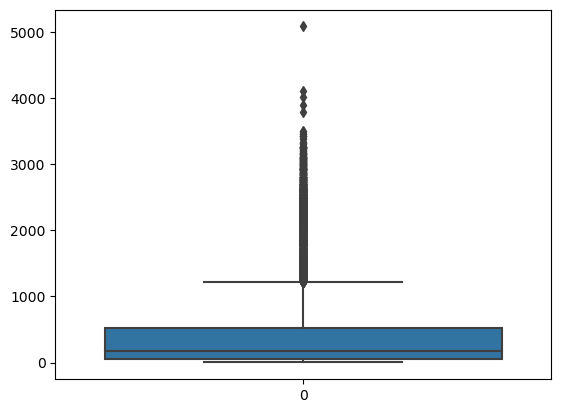

In [19]:
sns.boxplot(num_data.Unit_Price)

In [20]:
cat_data.Month.value_counts()

Month
June         3680
May          3676
December     3414
April        3283
March        3155
January      2907
February     2887
October      2554
November     2488
August       2304
September    2303
July         2215
Name: count, dtype: int64

In [21]:
cat_data.Month.nunique()

12

In [22]:
cat_data.Customer_Gender.value_counts()

Customer_Gender
M    17805
F    17061
Name: count, dtype: int64

In [23]:
cat_data.Customer_Gender.nunique()

2

In [24]:
cat_data.Country.value_counts()

Country
United States     18076
United Kingdom     6421
Germany            5201
France             5168
Name: count, dtype: int64

In [25]:
cat_data.Country.nunique()

4

In [26]:
cat_data.Product_Category.value_counts()

Product_Category
Accessories    22534
Bikes           7093
Clothing        5239
Name: count, dtype: int64

In [27]:
cat_data.Product_Category.nunique()

3

In [28]:
cat_data.Sub_Category.value_counts()

Sub_Category
Tires and Tubes      11112
Bottles and Cages     5295
Helmets               4176
Road Bikes            3022
Mountain Bikes        2737
Jerseys               2000
Caps                  1517
Touring Bikes         1334
Fenders                762
Shorts                 566
Cleaners               545
Gloves                 480
Hydration Packs        396
Socks                  364
Vests                  312
Bike Stands            145
Bike Racks             103
Name: count, dtype: int64

In [29]:
cat_data.Sub_Category.nunique()

17

<Axes: xlabel='Customer_Gender'>

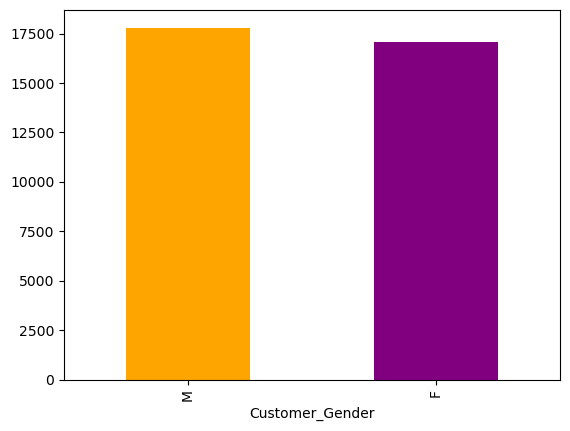

In [30]:
cat_data.Customer_Gender.value_counts().plot(kind = 'bar',color = ['orange','purple'])

<Axes: xlabel='Country'>

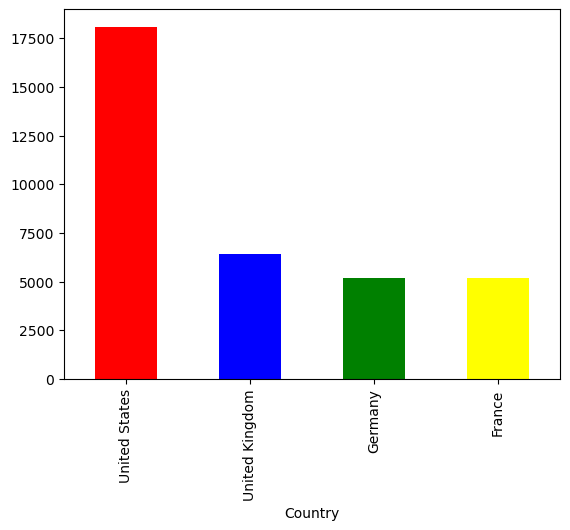

In [31]:
cat_data.Country.value_counts().plot(kind ='bar',color = ['red','blue','green','yellow'])

<Axes: >

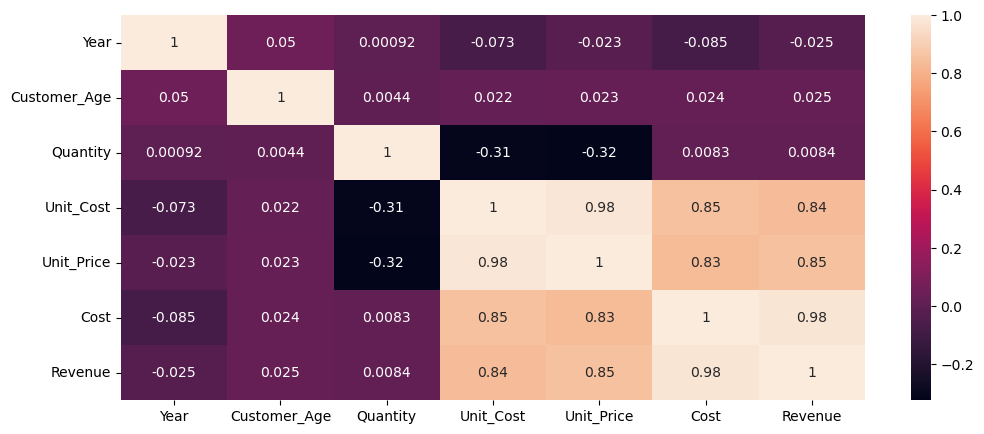

In [32]:
plt.figure(figsize=(12,5))
sns.heatmap(data.select_dtypes(['int','float']).corr(), annot = True)

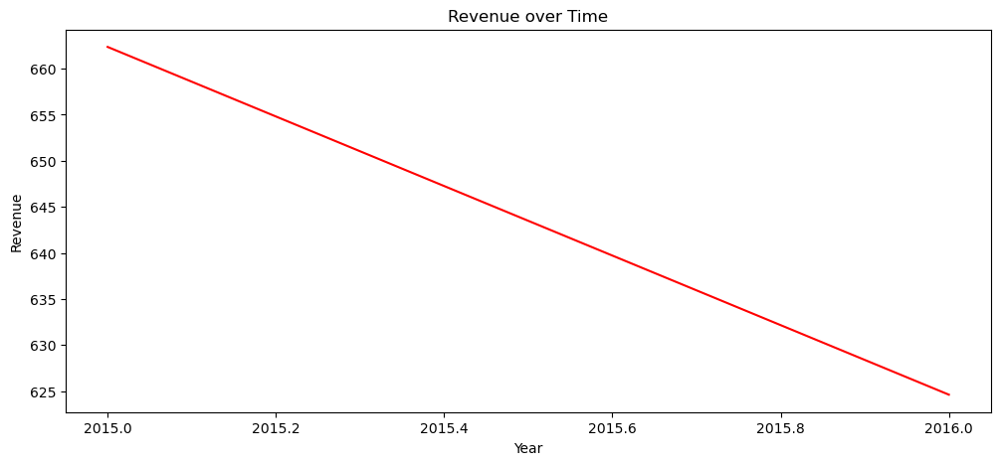

In [33]:
data.groupby('Year')['Revenue'].mean().round(2).plot(kind = 'line',figsize = (12,5),color = 'red')
plt.xlabel("Year")
plt.ylabel("Revenue")
plt.title("Revenue over Time")
plt.show()

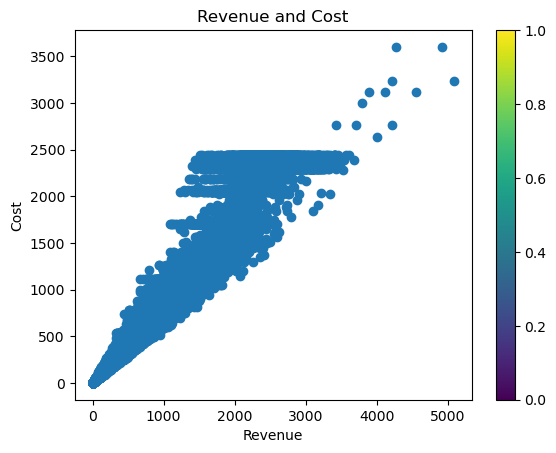

In [34]:
plt.scatter(data['Revenue'],data['Cost'])
plt.title("Revenue and Cost")
plt.xlabel('Revenue')
plt.ylabel('Cost')
plt.colorbar()
plt.show()

# One-hot encoding

In [35]:
cat_data.columns

Index(['Month', 'Customer_Gender', 'Country', 'State', 'Product_Category',
       'Sub_Category', 'index'],
      dtype='object')

In [36]:
cat_data.shape

(34866, 7)

In [37]:
cat_data = pd.get_dummies(cat_data,columns =['Customer_Gender','Country'],dtype=int)

In [38]:
cat_data.head()

,Month,State,Product_Category,Sub_Category,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States
0,February,Washington,Accessories,Tires and Tubes,0,1,0,0,0,0,1
1,February,Washington,Clothing,Gloves,1,1,0,0,0,0,1
2,February,Washington,Accessories,Tires and Tubes,2,1,0,0,0,0,1
3,March,Washington,Accessories,Tires and Tubes,3,1,0,0,0,0,1
4,March,Washington,Accessories,Tires and Tubes,4,1,0,0,0,0,1


In [39]:
cat_data.shape

(34866, 11)

In [40]:
cat_data = pd.get_dummies(cat_data,columns = ['Month','State', 'Product_Category','Sub_Category'],dtype = int)

In [41]:
cat_data.head()

,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,0,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,3,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,4,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [42]:
cat_data.shape

(34866, 84)

# Merging the data num and cat_data:

In [43]:
num_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index
0,2016,29,1,80.00,109.000000,80,109,0
1,2016,29,2,24.50,28.500000,49,57,1
2,2016,29,3,3.67,5.000000,11,15,2
3,2016,29,2,87.50,116.500000,175,233,3
4,2016,29,3,35.00,41.666667,105,125,4


In [44]:
num_data.shape

(34866, 8)

In [45]:
cat_data.head()

,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,0,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,3,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,4,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [46]:
cat_data.head()

,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,0,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,3,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,4,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [47]:
cat_data.shape

(34866, 84)

In [48]:
final_data = pd.merge(num_data,cat_data,how = 'inner',left_on = 'index',right_on = 'index')

In [49]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


In [50]:
final_data.shape

(34866, 91)

**Checking if the data is normally distributed

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


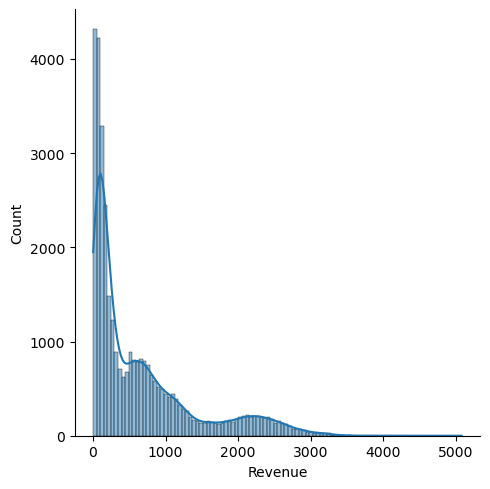

In [51]:
sns.displot(final_data.Revenue,kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


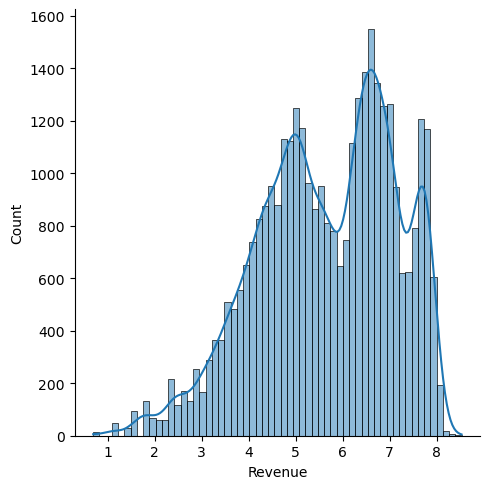

In [52]:
sns.displot(np.log(final_data.Revenue),kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


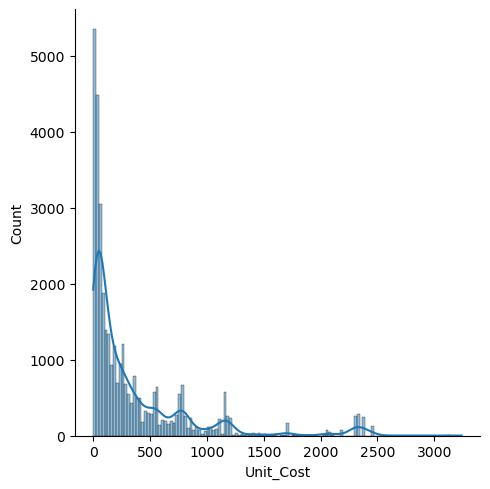

In [53]:
sns.displot(final_data.Unit_Cost,kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


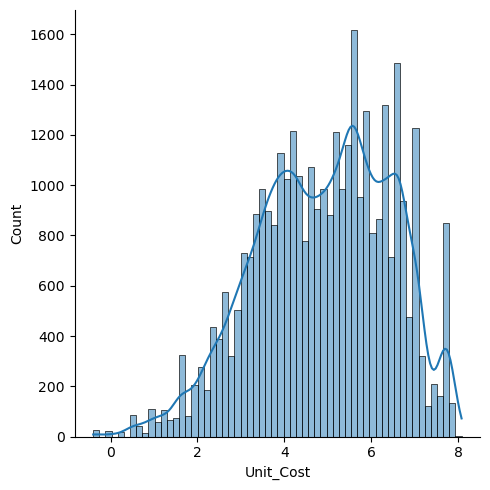

In [54]:
sns.displot(np.log(final_data.Unit_Cost),kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


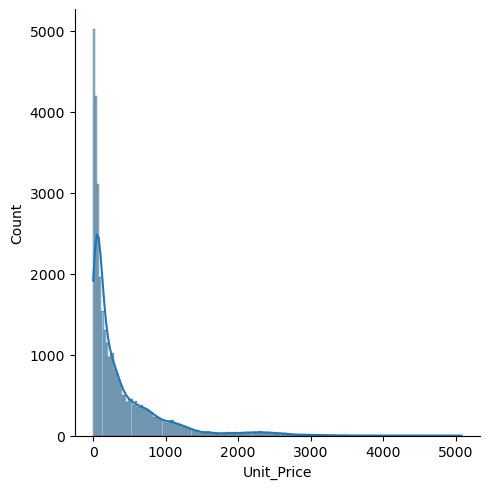

In [55]:
sns.displot(final_data.Unit_Price,kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


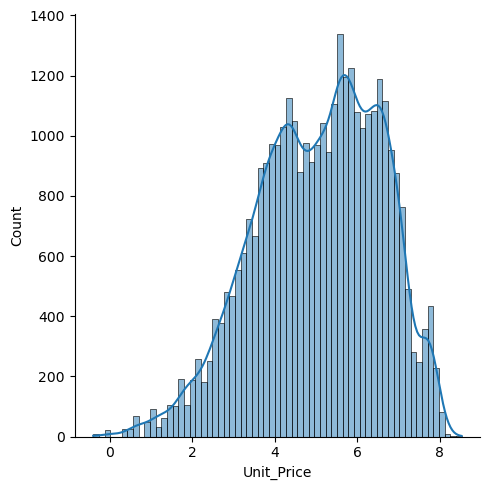

In [56]:
sns.displot(np.log(final_data.Unit_Price),kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


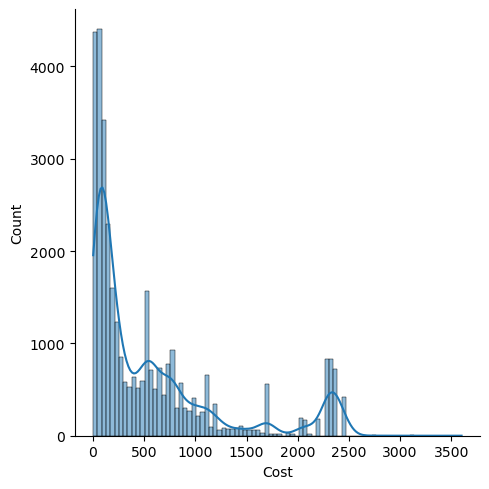

In [57]:
sns.displot(final_data.Cost,kde = True)

C:\Users\yash\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


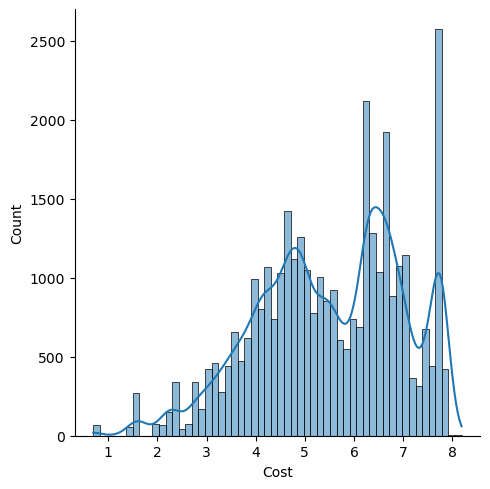

In [58]:
sns.displot(np.log(final_data.Cost),kde = True)

In [59]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


In [60]:
final_data_copy = final_data.copy()

In [61]:
final_data_copy['log_rev'] = np.log(final_data_copy['Revenue'])

In [62]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,1,0,0,4.691348
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,4.043051
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,1,0,0,2.708050
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,1,0,0,5.451038
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,1,0,0,4.828314


In [63]:
final_data_copy = final_data_copy.drop(columns='Revenue')

In [64]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,index,Customer_Gender_F,Customer_Gender_M,Country_France,...,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev
0,2016,29,1,80.00,109.000000,80,0,1,0,0,...,0,0,0,0,0,0,1,0,0,4.691348
1,2016,29,2,24.50,28.500000,49,1,1,0,0,...,0,0,0,0,0,0,0,0,0,4.043051
2,2016,29,3,3.67,5.000000,11,2,1,0,0,...,0,0,0,0,0,0,1,0,0,2.708050
3,2016,29,2,87.50,116.500000,175,3,1,0,0,...,0,0,0,0,0,0,1,0,0,5.451038
4,2016,29,3,35.00,41.666667,105,4,1,0,0,...,0,0,0,0,0,0,1,0,0,4.828314


In [65]:
final_data_copy['log_uc'] = np.log(final_data_copy['Unit_Cost'])

In [66]:
final_data_copy['log_up'] = np.log(final_data_copy['Unit_Price'])

In [67]:
final_data_copy['log_Cost'] = np.log(final_data_copy['Cost'])

In [68]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,index,Customer_Gender_F,Customer_Gender_M,Country_France,...,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,80.00,109.000000,80,0,1,0,0,...,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,24.50,28.500000,49,1,1,0,0,...,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,3.67,5.000000,11,2,1,0,0,...,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,87.50,116.500000,175,3,1,0,0,...,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,35.00,41.666667,105,4,1,0,0,...,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [69]:
final_data_copy = final_data_copy.drop(columns='Unit_Cost')

In [70]:
final_data_copy = final_data_copy.drop(columns='Unit_Price')

In [71]:
final_data_copy = final_data_copy.drop(columns='Cost')

In [72]:
final_data_copy.head()

,Year,Customer_Age,Quantity,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,...,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,0,1,0,0,0,0,1,...,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,1,0,0,0,0,1,...,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,2,1,0,0,0,0,1,...,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,3,1,0,0,0,0,1,...,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,4,1,0,0,0,0,1,...,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [73]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


# Feature Engineering

**Correlation Analysis:**

In [74]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [75]:
final_data = final_data.drop(columns = 'index')

In [76]:
corr = final_data.corrwith(final_data.Revenue).abs().sort_values(ascending = False)

In [77]:
corr

Revenue                           1.000000
Cost                              0.979119
Unit_Price                        0.851034
Unit_Cost                         0.836957
Product_Category_Bikes            0.671304
Product_Category_Accessories      0.571728
Sub_Category_Mountain Bikes       0.495437
Sub_Category_Tires and Tubes      0.355569
Sub_Category_Touring Bikes        0.311155
Sub_Category_Bottles and Cages    0.291180
Sub_Category_Road Bikes           0.274730
Sub_Category_Caps                 0.136694
Sub_Category_Shorts               0.100579
Country_Germany                   0.099601
Country_United States             0.094024
Sub_Category_Jerseys              0.092488
Sub_Category_Cleaners             0.083614
Sub_Category_Vests                0.069760
Sub_Category_Socks                0.065902
Sub_Category_Hydration Packs      0.054928
Sub_Category_Bike Racks           0.053694
State_Washington                  0.050434
State_Saarland                    0.047711
State_Calif

In [78]:
v = corr[np.abs(corr)>0.09].index.difference(['Revenue'])

In [79]:
v

Index(['Cost', 'Country_Germany', 'Country_United States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Sub_Category_Bottles and Cages', 'Sub_Category_Caps',
       'Sub_Category_Jerseys', 'Sub_Category_Mountain Bikes',
       'Sub_Category_Road Bikes', 'Sub_Category_Shorts',
       'Sub_Category_Tires and Tubes', 'Sub_Category_Touring Bikes',
       'Unit_Cost', 'Unit_Price'],
      dtype='object')

In [80]:
final_data_2 = final_data.loc[ : : ,['Cost', 'Country_Germany', 'Country_United States','Product_Category_Accessories', 'Product_Category_Bikes','Sub_Category_Bottles and Cages', 'Sub_Category_Caps','Sub_Category_Jerseys', 'Sub_Category_Mountain Bikes','Sub_Category_Road Bikes', 'Sub_Category_Shorts','Sub_Category_Tires and Tubes', 'Sub_Category_Touring Bikes','Unit_Cost', 'Unit_Price']]

In [81]:
final_data_2.head()

,Cost,Country_Germany,Country_United States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Unit_Cost,Unit_Price
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667


In [82]:
final_data_2.head()

,Cost,Country_Germany,Country_United States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Unit_Cost,Unit_Price
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667


In [83]:
final_data_2.shape

(34866, 15)

In [84]:
final_data_2.columns=[i.replace(' ','_')for i in final_data_2.columns ]

In [85]:
final_data_2.columns

Index(['Cost', 'Country_Germany', 'Country_United_States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Sub_Category_Bottles_and_Cages', 'Sub_Category_Caps',
       'Sub_Category_Jerseys', 'Sub_Category_Mountain_Bikes',
       'Sub_Category_Road_Bikes', 'Sub_Category_Shorts',
       'Sub_Category_Tires_and_Tubes', 'Sub_Category_Touring_Bikes',
       'Unit_Cost', 'Unit_Price'],
      dtype='object')

In [86]:
final_data_2.head()

,Cost,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Unit_Cost,Unit_Price
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667


In [87]:
final_data_copy.head(2)

,Year,Customer_Age,Quantity,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September,State_Alabama,State_Arizona,State_Bayern,State_Brandenburg,State_California,State_Charente-Maritime,State_England,State_Essonne,State_Florida,State_Garonne (Haute),State_Georgia,State_Hamburg,State_Hauts de Seine,State_Hessen,State_Illinois,State_Kentucky,State_Loir et Cher,State_Loiret,State_Massachusetts,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Moselle,State_New York,State_Nord,State_Nordrhein-Westfalen,State_North Carolina,State_Ohio,State_Oregon,State_Pas de Calais,State_Saarland,State_Seine (Paris),State_Seine Saint Denis,State_Seine et Marne,State_Somme,State_South Carolina,State_Texas,State_Utah,State_Val d'Oise,State_Val de Marne,State_Virginia,State_Washington,State_Wyoming,State_Yveline,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bike Racks,Sub_Category_Bike Stands,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Fenders,Sub_Category_Gloves,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820


In [88]:
corr2 = final_data_copy.corrwith(final_data_copy.log_rev).abs().sort_values(ascending = False)
corr2

log_rev                           1.000000
log_Cost                          0.994874
log_up                            0.954351
log_uc                            0.951257
Product_Category_Bikes            0.549327
Product_Category_Accessories      0.520428
Sub_Category_Tires and Tubes      0.405044
Sub_Category_Mountain Bikes       0.354248
Sub_Category_Bottles and Cages    0.313755
Sub_Category_Road Bikes           0.287116
Sub_Category_Touring Bikes        0.234973
Sub_Category_Jerseys              0.147748
Sub_Category_Helmets              0.142376
Sub_Category_Caps                 0.115412
Sub_Category_Shorts               0.103770
Product_Category_Clothing         0.077495
Sub_Category_Vests                0.076257
Sub_Category_Cleaners             0.075514
Country_Germany                   0.075035
Sub_Category_Hydration Packs      0.074526
Country_United States             0.072380
index                             0.071286
Sub_Category_Socks                0.054980
Sub_Categor

In [89]:
final_data_copy = final_data_copy.drop(columns = 'index')

We are taking a cut-off of 0.07 as per looking at the correlation values and we wanted at max 25 variables as per the data.

In [90]:
w = corr2[np.abs(corr2)>0.07].index.difference(['log_rev'])
w

Index(['Country_Germany', 'Country_United States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Product_Category_Clothing', 'Sub_Category_Bottles and Cages',
       'Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets',
       'Sub_Category_Hydration Packs', 'Sub_Category_Jerseys',
       'Sub_Category_Mountain Bikes', 'Sub_Category_Road Bikes',
       'Sub_Category_Shorts', 'Sub_Category_Tires and Tubes',
       'Sub_Category_Touring Bikes', 'Sub_Category_Vests', 'index', 'log_Cost',
       'log_uc', 'log_up'],
      dtype='object')

In [91]:
fd_copy2 = final_data_copy.loc[ : : ,['Country_Germany', 'Country_United States','Product_Category_Accessories', 'Product_Category_Bikes','Product_Category_Clothing', 'Sub_Category_Bottles and Cages','Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets','Sub_Category_Hydration Packs', 'Sub_Category_Jerseys','Sub_Category_Mountain Bikes', 'Sub_Category_Road Bikes','Sub_Category_Shorts', 'Sub_Category_Tires and Tubes','Sub_Category_Touring Bikes', 'Sub_Category_Vests', 'log_Cost','log_uc', 'log_up']]

In [92]:
fd_copy2.head(3)

,Country_Germany,Country_United States,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_Cost,log_uc,log_up
0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.382027,4.382027,4.691348
1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,3.891820,3.198673,3.349904
2,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2.397895,1.300192,1.609438


In [93]:
fd_copy2.shape

(34866, 20)

In [94]:
fd_copy2.columns=[i.replace(' ','_')for i in fd_copy2.columns]

In [95]:
fd_copy2.columns

Index(['Country_Germany', 'Country_United_States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Product_Category_Clothing', 'Sub_Category_Bottles_and_Cages',
       'Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets',
       'Sub_Category_Hydration_Packs', 'Sub_Category_Jerseys',
       'Sub_Category_Mountain_Bikes', 'Sub_Category_Road_Bikes',
       'Sub_Category_Shorts', 'Sub_Category_Tires_and_Tubes',
       'Sub_Category_Touring_Bikes', 'Sub_Category_Vests', 'log_Cost',
       'log_uc', 'log_up'],
      dtype='object')

**Splitting the final dataset into Training and Testing dataset**

In [96]:
!pip install scikit-learn

In [97]:
import sklearn

In [98]:
from sklearn.model_selection import train_test_split

In [99]:
final_data_2['Revenue'] = final_data['Revenue']

In [100]:
train,test = train_test_split(final_data_2,test_size = 0.3, random_state = 123)

In [101]:
train.shape

(24406, 16)

In [102]:
test.shape

(10460, 16)

Just do train-test split for the new data.

In [103]:
fd_copy2['log_Revenue'] = final_data_copy['log_rev']

In [104]:
log_train,log_test = train_test_split(fd_copy2,test_size = 0.3, random_state = 123)

In [105]:
log_train.shape

(24406, 21)

In [106]:
log_test.shape

(10460, 21)

**Building the Regression model:**

In [107]:
formula = 'Revenue~' + '+'.join(train.columns.difference(['Revenue']))

In [108]:
formula2 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories']))

In [109]:
form3 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories','Sub_Category_Shorts']))

In [110]:
form4 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories','Sub_Category_Shorts','Sub_Category_Jerseys']))

In [111]:
from sklearn import datasets, linear_model

In [112]:
formula 

'Revenue~Cost+Country_Germany+Country_United_States+Product_Category_Accessories+Product_Category_Bikes+Sub_Category_Bottles_and_Cages+Sub_Category_Caps+Sub_Category_Jerseys+Sub_Category_Mountain_Bikes+Sub_Category_Road_Bikes+Sub_Category_Shorts+Sub_Category_Tires_and_Tubes+Sub_Category_Touring_Bikes+Unit_Cost+Unit_Price'

In [113]:
model = smf.ols(form4, train).fit()

In [114]:
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                Revenue   R-squared:                       0.993
Model:                            OLS   Adj. R-squared:                  0.993
Method:                 Least Squares   F-statistic:                 3.123e+05
Date:                Thu, 01 Aug 2024   Prob (F-statistic):               0.00
Time:                        15:03:34   Log-Likelihood:            -1.3532e+05
No. Observations:               24406   AIC:                         2.707e+05
Df Residuals:                   24394   BIC:                         2.708e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

In [115]:
pred_Revenue = model.predict(train)
pred_Revenue

34256      32.971292
5858     2155.912260
2839     1317.076457
1188      895.536612
7144      332.180892
30589     654.685533
3745     2995.841312
10182    1803.198047
27774    2521.347757
7266      598.190232
20788     614.719069
23975    1666.271128
26696     433.055045
18915    2232.176311
24814     204.993028
17905     215.649433
28426     513.864795
28034     301.062783
18739     612.423892
30505     521.289037
14820    2309.419907
961      1377.685989
27880     599.556923
3124      118.542757
3609     2228.394797
30940     351.970437
13892     102.630802
29285    2450.115693
18108     169.190451
32819     874.895333
25239    1046.423382
5054     3188.185684
17830     258.978548
7830     2218.407970
14500      73.668954
20721     216.388769
33546    1007.888316
5609      117.725425
7578       83.990457
33323     918.982451
18840     127.581928
7450      260.021013
14197     616.298379
25456    1750.196787
26594     125.028895
22524     506.181654
9917      551.423744
21322     823

In [116]:
train['Revenue']

34256      33
5858     1784
2839     1342
1188      861
7144      325
30589     659
3745     2925
10182    1818
27774    2526
7266      554
20788     673
23975    1483
26696     448
18915    2141
24814     214
17905     171
28426     531
28034     259
18739     584
30505     514
14820    2237
961      1620
27880     600
3124      122
3609     1967
30940     295
13892     109
29285    2342
18108     133
32819     880
25239     974
5054     3044
17830     251
7830     2115
14500      70
20721     206
33546    1065
5609      112
7578       86
33323     983
18840     136
7450      244
14197     620
25456    1696
26594     122
22524     436
9917      546
21322     804
16550     719
23998     551
20810     224
24798     862
21088     302
33176      64
14330    2265
12105     541
25290     134
26801      61
9409      105
30006      86
4729      222
28296     253
12412     574
34323     970
13433    3103
4913     1760
29882     700
24018     233
3194      537
5120      602
11773      32
5795  

In [117]:
Result = pd.DataFrame(pd.concat([train['Revenue'],pred_Revenue],axis = 1))

In [118]:
Result = Result.rename(columns = {0:'Prediction'})

In [119]:
Result.head()

,Revenue,Prediction
34256,33,32.971292
5858,1784,2155.912260
2839,1342,1317.076457
1188,861,895.536612
7144,325,332.180892


In [120]:
Result['Error'] = np.abs(Result['Revenue'] - Result['Prediction'])

In [121]:
Result.head()

,Revenue,Prediction,Error
34256,33,32.971292,0.028708
5858,1784,2155.912260,371.912260
2839,1342,1317.076457,24.923543
1188,861,895.536612,34.536612
7144,325,332.180892,7.180892


In [122]:
Result['Percent_Error'] = (Result['Error']/Result['Revenue'])*100

In [123]:
Result.head()

,Revenue,Prediction,Error,Percent_Error
34256,33,32.971292,0.028708,0.086993
5858,1784,2155.912260,371.912260,20.847100
2839,1342,1317.076457,24.923543,1.857194
1188,861,895.536612,34.536612,4.011221
7144,325,332.180892,7.180892,2.209505


In [124]:
MAPE= np.round(np.mean(Result['Percent_Error']),2)
MAPE

9.79

MAPE error is less than 10-12% (maximum MAPE allowable) 

In [125]:
pred_Reve_test = model.predict(test)
pred_Reve_test

16517      40.743199
17069    2109.806418
29048     135.452937
10533      93.505618
4850      613.715234
1418      715.640745
19204      59.383296
15424     713.131047
24202     728.869090
19618     558.356679
34119     220.705744
17274       7.855304
31087     254.773660
25821      57.510866
8204      977.396943
34758     609.093994
22425     138.815351
2539     3440.846156
2759     2863.682295
7894     2303.183034
2217     1020.563006
12491      30.198722
11213     150.121675
1835        9.341679
1266       67.036528
13157     128.945086
15686      90.080579
24052     380.068389
12687      94.294883
21757    2488.434560
5344       80.694800
6159     2374.500686
5119      144.005381
32397    2551.626407
11558     147.059551
25038     112.493764
783       105.061729
3211      336.910405
23014     721.176260
20324     147.814869
15132     936.023151
16750     616.224258
13259     574.652263
17411     140.967001
11083      30.156676
3435      648.782921
6723      239.452203
16631    2255

In [126]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September,State_Alabama,State_Arizona,State_Bayern,State_Brandenburg,State_California,State_Charente-Maritime,State_England,State_Essonne,State_Florida,State_Garonne (Haute),State_Georgia,State_Hamburg,State_Hauts de Seine,State_Hessen,State_Illinois,State_Kentucky,State_Loir et Cher,State_Loiret,State_Massachusetts,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Moselle,State_New York,State_Nord,State_Nordrhein-Westfalen,State_North Carolina,State_Ohio,State_Oregon,State_Pas de Calais,State_Saarland,State_Seine (Paris),State_Seine Saint Denis,State_Seine et Marne,State_Somme,State_South Carolina,State_Texas,State_Utah,State_Val d'Oise,State_Val de Marne,State_Virginia,State_Washington,State_Wyoming,State_Yveline,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bike Racks,Sub_Category_Bike Stands,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Fenders,Sub_Category_Gloves,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [127]:
pred_Revenue

34256      32.971292
5858     2155.912260
2839     1317.076457
1188      895.536612
7144      332.180892
30589     654.685533
3745     2995.841312
10182    1803.198047
27774    2521.347757
7266      598.190232
20788     614.719069
23975    1666.271128
26696     433.055045
18915    2232.176311
24814     204.993028
17905     215.649433
28426     513.864795
28034     301.062783
18739     612.423892
30505     521.289037
14820    2309.419907
961      1377.685989
27880     599.556923
3124      118.542757
3609     2228.394797
30940     351.970437
13892     102.630802
29285    2450.115693
18108     169.190451
32819     874.895333
25239    1046.423382
5054     3188.185684
17830     258.978548
7830     2218.407970
14500      73.668954
20721     216.388769
33546    1007.888316
5609      117.725425
7578       83.990457
33323     918.982451
18840     127.581928
7450      260.021013
14197     616.298379
25456    1750.196787
26594     125.028895
22524     506.181654
9917      551.423744
21322     823

In [128]:
final_data_copy['log_rev'] = final_data_copy['log_rev']

In [129]:
final_data_2.head()

,Cost,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Unit_Cost,Unit_Price,Revenue
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000,109
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000,57
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000,15
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000,233
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667,125


**Building a Regression model on the new dataset:**

In [130]:
log_train.head()

,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Helmets,Sub_Category_Hydration_Packs,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Sub_Category_Vests,log_Cost,log_uc,log_up,log_Revenue
34256,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,3.401197,3.401197,3.496508,3.496508
5858,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,7.738488,6.639876,6.388001,7.486613
2839,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,7.033506,6.340359,6.508769,7.201916
1188,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,6.733402,6.040255,6.064947,6.758095
7144,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,5.669881,5.669881,5.783825,5.783825


In [131]:
log_formula1 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue']))

In [132]:
log_formula2 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States']))

In [133]:
log_formula3 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes']))

In [134]:
log_formula4 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps']))

In [135]:
log_formula5 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany']))

In [136]:
log_formula6 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany','Sub_Category_Cleaners']))

In [137]:
log_formula7 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany','Sub_Category_Cleaners','Sub_Category_Vests']))

In [138]:
log_formula1

'log_Revenue~Country_Germany+Country_United_States+Product_Category_Accessories+Product_Category_Bikes+Product_Category_Clothing+Sub_Category_Bottles_and_Cages+Sub_Category_Caps+Sub_Category_Cleaners+Sub_Category_Helmets+Sub_Category_Hydration_Packs+Sub_Category_Jerseys+Sub_Category_Mountain_Bikes+Sub_Category_Road_Bikes+Sub_Category_Shorts+Sub_Category_Tires_and_Tubes+Sub_Category_Touring_Bikes+Sub_Category_Vests+log_Cost+log_uc+log_up'

In [139]:
model_new = smf.ols(log_formula7, log_train).fit()

In [140]:
print(model_new.summary())

                            OLS Regression Results                            
Dep. Variable:            log_Revenue   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.017e+11
Date:                Thu, 01 Aug 2024   Prob (F-statistic):               0.00
Time:                        15:08:12   Log-Likelihood:             1.7264e+05
No. Observations:               24406   AIC:                        -3.453e+05
Df Residuals:                   24393   BIC:                        -3.451e+05
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

In [141]:
pred_log_rev = model_new.predict(log_train)
pred_log_rev

34256    3.496542
5858     7.486605
2839     7.201902
1188     6.758077
7144     5.783789
30589    6.490722
3745     7.981022
10182    7.505470
27774    7.834384
7266     6.317140
20788    6.511775
23975    7.301815
26696    6.104803
18915    7.669002
24814    5.365983
17905    5.141671
28426    6.274746
28034    5.556815
18739    6.369906
30505    6.242201
14820    7.712881
961      7.390151
27880    6.396926
3124     4.804026
3609     7.584259
30940    5.686973
13892    4.691254
29285    7.758753
18108    4.890353
32819    6.779909
25239    6.881394
5054     8.020911
17830    5.525425
7830     7.656799
14500    4.248524
20721    5.327885
33546    6.970716
5609     4.718505
7578     4.454373
33323    6.890635
18840    4.912675
7450     5.497176
14197    6.429695
25456    7.435963
26594    4.804027
22524    6.077617
9917     6.302634
21322    6.689575
16550    6.577840
23998    6.311723
20810    5.411652
24798    6.759248
21088    5.710411
33176    4.158757
14330    7.725328
12105    6

In [142]:
predicted_revenue= np.exp(pred_log_rev)

In [143]:
predicted_revenue=np.round(predicted_revenue,3)

In [144]:
predicted_revenue

34256      33.001
5858     1783.986
2839     1341.981
1188      860.985
7144      324.988
30589     658.999
3745     2924.920
10182    1817.959
27774    2525.978
7266      553.986
20788     673.020
23975    1482.990
26696     448.004
18915    2140.945
24814     214.001
17905     171.001
28426     530.992
28034     258.996
18739     584.003
30505     513.989
14820    2236.977
961      1619.951
27880     599.998
3124      122.001
3609     1966.989
30940     294.999
13892     108.990
29285    2341.983
18108     133.001
32819     879.989
25239     973.983
5054     3043.951
17830     250.993
7830     2114.977
14500      70.002
20721     206.002
33546    1064.985
5609      112.001
7578       86.002
33323     983.025
18840     136.003
7450      244.002
14197     619.985
25456    1695.889
26594     122.001
22524     435.989
9917      546.008
21322     803.980
16550     718.985
23998     550.993
20810     224.001
24798     861.994
21088     301.995
33176      63.992
14330    2264.995
12105     

In [145]:
Result_2 = pd.DataFrame(pd.concat([train['Revenue'],predicted_revenue],axis = 1))

In [146]:
Result_2 

,Revenue,0
34256,33,33.001
5858,1784,1783.986
2839,1342,1341.981
1188,861,860.985
7144,325,324.988
30589,659,658.999
3745,2925,2924.920
10182,1818,1817.959
27774,2526,2525.978
7266,554,553.986


In [147]:
Result_2 = Result_2.rename(columns = {0:'Prediction'})

In [148]:
Result_2

,Revenue,Prediction
34256,33,33.001
5858,1784,1783.986
2839,1342,1341.981
1188,861,860.985
7144,325,324.988
30589,659,658.999
3745,2925,2924.920
10182,1818,1817.959
27774,2526,2525.978
7266,554,553.986


In [149]:
Result_2['Error'] = np.abs(Result_2['Revenue'] - Result_2['Prediction'])

In [150]:
Result_2['Percent_Error'] = (Result_2['Error']/Result_2['Revenue'])*100

In [151]:
Result_2

,Revenue,Prediction,Error,Percent_Error
34256,33,33.001,0.001,0.003030
5858,1784,1783.986,0.014,0.000785
2839,1342,1341.981,0.019,0.001416
1188,861,860.985,0.015,0.001742
7144,325,324.988,0.012,0.003692
30589,659,658.999,0.001,0.000152
3745,2925,2924.920,0.080,0.002735
10182,1818,1817.959,0.041,0.002255
27774,2526,2525.978,0.022,0.000871
7266,554,553.986,0.014,0.002527


In [152]:
MAPE_2= np.round(np.mean(Result_2['Percent_Error']),2)
MAPE_2

0.0

In [153]:
pred_test=model_new.predict(log_test)

In [154]:
pred_test=np.exp(pred_test)

In [155]:
pred_test

16517      43.001980
17069    2076.958719
29048     139.991230
10533      91.003041
4850      680.992377
1418      651.021956
19204      56.001012
15424     804.992093
24202     739.965646
19618     545.998797
34119     239.002247
17274       4.000375
31087     267.996085
25821      60.002205
8204      933.978197
34758     677.993111
22425     142.003159
2539     3244.952387
2759     3134.995906
7894     2377.960694
2217     1015.969060
12491      26.001303
11213     151.998798
1835       13.000811
1266       65.001533
13157     142.000854
15686      90.999643
24052     380.986992
12687     103.001178
21757    2540.011329
5344       77.000165
6159     2412.950281
5119      146.001725
32397    2525.952403
11558     144.000159
25038     125.014058
783        68.002846
3211      285.994246
23014     741.996544
20324     157.003286
15132     947.987804
16750     601.980908
13259     626.994284
17411     148.000381
11083      31.012815
3435      680.015534
6723      251.002946
16631    2312

In [156]:
Result_2_test = pd.DataFrame(pd.concat([test['Revenue'],pred_test],axis = 1))

In [157]:
Result_2_test

,Revenue,0
16517,43,43.001980
17069,2077,2076.958719
29048,140,139.991230
10533,91,91.003041
4850,681,680.992377
1418,651,651.021956
19204,56,56.001012
15424,805,804.992093
24202,740,739.965646
19618,546,545.998797


In [158]:
Result_2_test = Result_2_test.rename(columns = {0:'Prediction'})
Result_2_test['Error'] = np.abs(Result_2_test['Revenue'] - Result_2_test['Prediction'])
Result_2_test['Percent_Error'] = (Result_2_test['Error']/Result_2_test['Revenue'])*100

In [159]:
Result_2_test

,Revenue,Prediction,Error,Percent_Error
16517,43,43.001980,0.001980,0.004604
17069,2077,2076.958719,0.041281,0.001988
29048,140,139.991230,0.008770,0.006264
10533,91,91.003041,0.003041,0.003342
4850,681,680.992377,0.007623,0.001119
1418,651,651.021956,0.021956,0.003373
19204,56,56.001012,0.001012,0.001807
15424,805,804.992093,0.007907,0.000982
24202,740,739.965646,0.034354,0.004642
19618,546,545.998797,0.001203,0.000220


In [160]:
MAPE_2_test= np.round(np.mean(Result_2_test['Percent_Error']),2)
MAPE_2_test

0.0

In [161]:
print("Training Dataset MAPE error:",MAPE_2)
print("Testing Dataset MAPE error:",MAPE_2_test)

Training Dataset MAPE error: 0.0
Testing Dataset MAPE error: 0.0


Model_new is a perfect Regression model with Zero overfitting it. R Square value is 100%